In [26]:
!pip install -q catboost
!pip install -q lightgbm

In [27]:
import gc
import os
import lightgbm
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
from catboost import Pool, CatBoostRegressor
from sklearn.metrics import mean_absolute_error

In [28]:
# import kagglehub
# kagglehub.login()наверное
playground_series_s3e14_path = kagglehub.competition_download('playground-series-s3e14')

In [38]:
train_df = pd.read_csv(os.path.join(playground_series_s3e14_path, 'train.csv'))
test_df = pd.read_csv(os.path.join(playground_series_s3e14_path, 'test.csv'))
train_df['yield_beyond_q75'] = np.where(train_df['yield'] >= train_df['yield'].quantile(q=0.75), 1, 0)

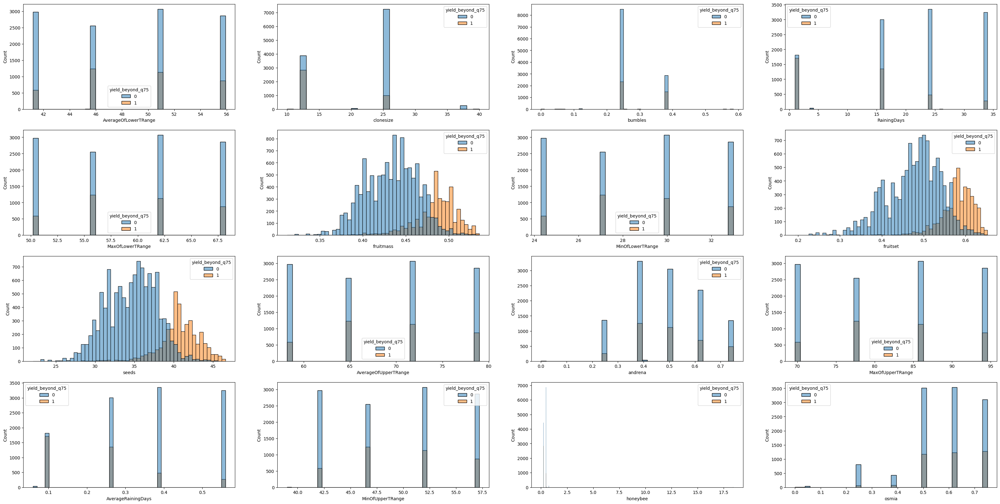

In [30]:
nrows, ncols = 4, 4

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(40, 20))
columns = list(set(list(train_df.columns)) - set(['id', 'yield', 'yield_beyond_q75']))

col = 0
for i in range(nrows):
    for j in range(ncols):
        sns.histplot(data=train_df, x=columns[col], hue='yield_beyond_q75', ax=axes[i, j])
        col += 1

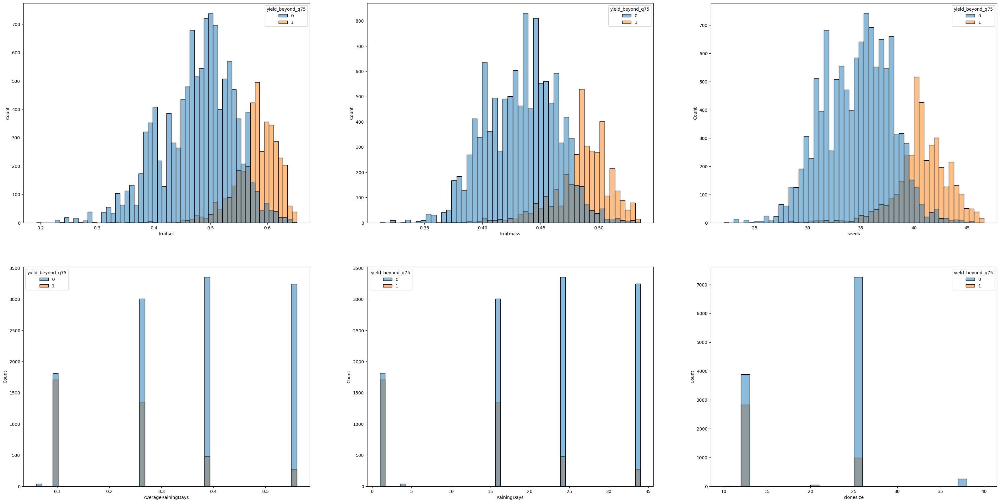

In [41]:
nrows, ncols = 2, 3

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(40, 20))
columns = ['fruitset', 'fruitmass', 'seeds', 'AverageRainingDays', 'RainingDays', 'clonesize']

col = 0
for i in range(nrows):
    for j in range(ncols):
        sns.histplot(data=train_df, x=columns[col], hue='yield_beyond_q75', ax=axes[i, j])
        col += 1

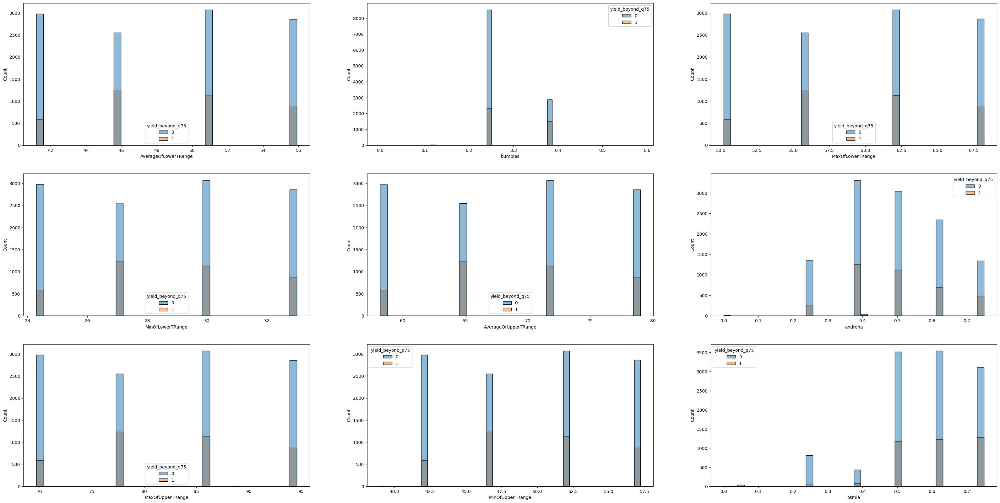

In [44]:
nrows, ncols = 3, 3

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(40, 20))
columns = ['AverageOfLowerTRange', 'bumbles', 'MaxOfLowerTRange', 'MinOfLowerTRange', 'AverageOfUpperTRange', 'andrena', 'MaxOfUpperTRange', 'MinOfUpperTRange', 'osmia']

col = 0
for i in range(nrows):
    for j in range(ncols):
        sns.histplot(data=train_df, x=columns[col], hue='yield_beyond_q75', ax=axes[i, j])
        col += 1


In [31]:
X_train, y_train = train_df.drop(columns=['yield', 'id', 'yield_beyond_q75']), train_df['yield'].copy()
X_test = test_df.drop(columns=['id'])

## CatBoost

<ipython-input-32-2d156211efac>:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  feature_plot = sns.barplot(x="Importances", y="Feature Id", data=catboost_feature_importance, palette="cool")


Text(0.5, 1.0, 'Features importance by CatBoost measured on 20 folds')

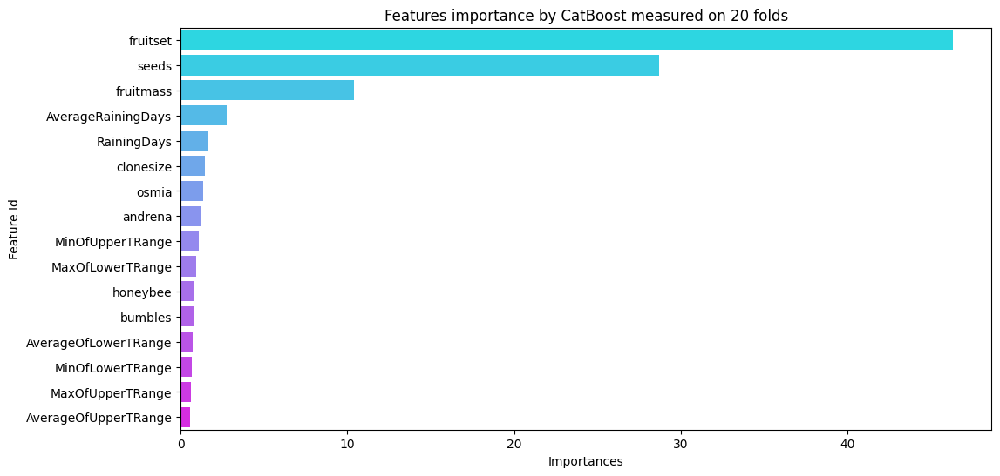

In [32]:
NFOLDS = 20
folds = KFold(n_splits=NFOLDS)
splits = folds.split(X_train, y_train)
catboost_feature_importance = None

cat_features = np.where(X_train.dtypes != np.float64)[0]

for _, (train_index, valid_index) in enumerate(splits):
    X_tr, X_val = X_train.iloc[train_index], X_train.iloc[valid_index]
    y_tr, y_val = y_train.iloc[train_index], y_train.iloc[valid_index]

    catboost_reg = CatBoostRegressor(loss_function='MAE', random_state=42, cat_features=cat_features, early_stopping_rounds=2000, iterations=10_000)
    catboost_reg.fit(X_tr, y_tr, eval_set=(X_val, y_val), silent=True)

    if catboost_feature_importance is None:
        catboost_feature_importance = catboost_reg.get_feature_importance(prettified=True)
        catboost_feature_importance["Importances"] /= NFOLDS
    else:
        catboost_feature_importance["Importances"] += catboost_reg.get_feature_importance(prettified=True)["Importances"] / NFOLDS

plt.figure(figsize=(12, 6))
feature_plot = sns.barplot(x="Importances", y="Feature Id", data=catboost_feature_importance, palette="cool")
plt.title(f"Features importance by CatBoost measured on {NFOLDS} folds")

In [33]:
NFOLDS = 20
folds = KFold(n_splits=NFOLDS)
splits = folds.split(X_train, y_train)
y_preds_catboost, score = np.zeros(X_test.shape[0]), 0

columns = ['fruitset', 'seeds', 'fruitmass', 'AverageRainingDays']

cat_features = np.where(X_train[columns].dtypes != np.float64)[0]

for fold_n, (train_index, valid_index) in enumerate(splits):
    X_tr, X_val = X_train[columns].iloc[train_index], X_train[columns].iloc[valid_index]
    y_tr, y_val = y_train.iloc[train_index], y_train.iloc[valid_index]

    catboost_reg = CatBoostRegressor(loss_function='MAE', random_state=42, cat_features=cat_features, early_stopping_rounds=2000, iterations=10_000)
    catboost_reg.fit(X_tr, y_tr, eval_set=(X_val, y_val), plot=True, silent=True)

    y_pred_valid = catboost_reg.predict(X_val)

    print(f"Fold {fold_n + 1} | MAE: {mean_absolute_error(y_val, y_pred_valid)}")
    score += mean_absolute_error(y_val, y_pred_valid) / NFOLDS

    y_preds_catboost += catboost_reg.predict(X_test[columns]) / NFOLDS
    del X_tr, X_val, y_tr, y_val
    gc.collect()

print(f"\nMean MAE = {score}")

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 1 | MAE: 353.4224196602998


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 2 | MAE: 357.7115056161329


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 3 | MAE: 323.8999411174925


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 4 | MAE: 352.0375269659719


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 5 | MAE: 373.20793894187494


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 6 | MAE: 336.04586613187337


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 7 | MAE: 348.40727237196376


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 8 | MAE: 333.0739579099023


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 9 | MAE: 325.9376429998348


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 10 | MAE: 348.9495840723546


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 11 | MAE: 344.3909810062459


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 12 | MAE: 351.6802804783759


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 13 | MAE: 327.44130066469916


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 14 | MAE: 346.6288549121552


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 15 | MAE: 350.52587616226134


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 16 | MAE: 318.81962693575775


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 17 | MAE: 382.18080224984715


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 18 | MAE: 323.92249524580393


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 19 | MAE: 361.022881413252


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Fold 20 | MAE: 321.8575263532888

Mean MAE = 344.05821406046937


## LightGBM

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2990
[LightGBM] [Info] Number of data points in the train set: 14524, number of used features: 16
[LightGBM] [Info] Start training from score 6115.947266
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000634 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2974
[LightGBM] [Info] Number of data points in the train set: 14524, number of used features: 16
[LightGBM] [Info] Start training from score 6115.947266
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000627 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2987
[LightGBM] [Info] Number of data points in the train set: 14524, number of used features: 16
[LightGBM] [Info] Sta

<ipython-input-34-8ffead6ff97c>:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  feature_plot = sns.barplot(x="Importances", y="Feature Id", data=lightgbm_feature_importance, palette="cool")


Text(0.5, 1.0, 'Features importance by LightGBM measured on 20 folds')

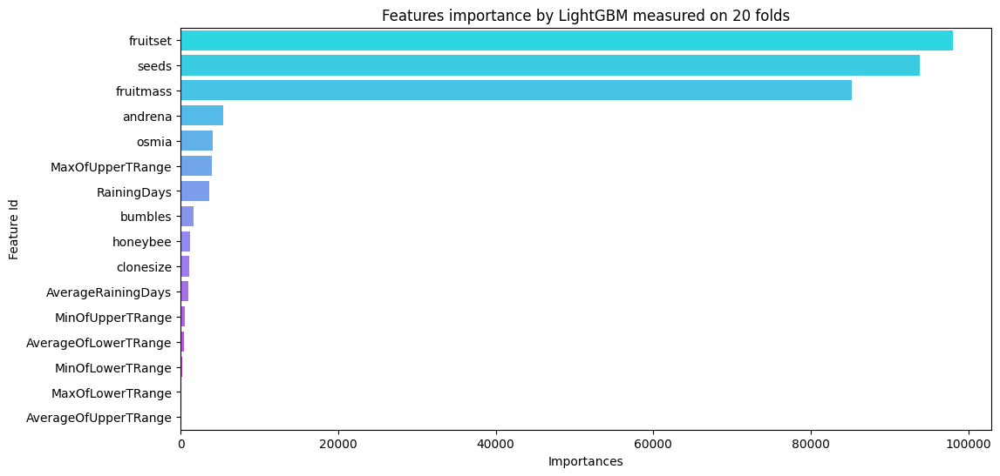

In [34]:
cat_cols = set(list(X_train.columns)) - set(['fruitset', 'fruitmass', 'seeds'])

for col in cat_cols:
    X_train[col] = X_train[col].astype('category')
    X_test[col] = X_test[col].astype('category')

NFOLDS = 20
folds = KFold(n_splits=NFOLDS)
splits = folds.split(X_train, y_train)

lightgbm_feature_importance = None

for fold_n, (train_index, valid_index) in enumerate(splits):
    X_tr, X_val = X_train.iloc[train_index], X_train.iloc[valid_index]
    y_tr, y_val = y_train.iloc[train_index], y_train.iloc[valid_index]

    lightgbm_reg = lightgbm.LGBMRegressor(objective='regression_l1', learning_rate=0.005, max_bin=5000, metric='mae', n_estimators=10_000, n_jobs=-1)
    lightgbm_reg.fit(X_tr, y_tr, eval_set=(X_val, y_val))

    if lightgbm_feature_importance is None:
        lightgbm_feature_importance = pd.DataFrame({'Feature Id': X_train.columns, 'Importances': lightgbm_reg.feature_importances_})
        lightgbm_feature_importance["Importances"] /= NFOLDS
    else:
        lightgbm_feature_importance["Importances"] += lightgbm_reg.feature_importances_ / NFOLDS

lightgbm_feature_importance = lightgbm_feature_importance.sort_values(by="Importances", ascending=False)

plt.figure(figsize=(12, 6))
feature_plot = sns.barplot(x="Importances", y="Feature Id", data=lightgbm_feature_importance, palette="cool")
plt.title(f"Features importance by LightGBM measured on {NFOLDS} folds")

In [35]:
cat_cols = ['andrena', 'osmia', 'MaxOfUpperTRange', 'RainingDays']

for col in cat_cols:
    X_train[col] = X_train[col].astype('category')
    X_test[col] = X_test[col].astype('category')

columns = ['fruitset', 'fruitmass', 'seeds'] + cat_cols

NFOLDS = 20
folds = KFold(n_splits=NFOLDS)
splits = folds.split(X_train, y_train)
y_preds_lightgbm, score = np.zeros(X_test.shape[0]), 0

for fold_n, (train_index, valid_index) in enumerate(splits):
    X_tr, X_val = X_train[columns].iloc[train_index], X_train[columns].iloc[valid_index]
    y_tr, y_val = y_train.iloc[train_index], y_train.iloc[valid_index]

    lightgbm_reg = lightgbm.LGBMRegressor(objective='regression_l1', learning_rate=0.01, max_bin=5000, metric='mae', n_estimators=10_000, n_jobs=-1)
    lightgbm_reg.fit(X_tr, y_tr, eval_set=(X_val, y_val))

    y_pred_valid = lightgbm_reg.predict(X_val)

    print(f"Fold {fold_n + 1} | MAE: {mean_absolute_error(y_val, y_pred_valid)}")
    score += mean_absolute_error(y_val, y_pred_valid) / NFOLDS

    y_preds_lightgbm += lightgbm_reg.predict(X_test[columns]) / NFOLDS
    del X_tr, X_val, y_tr, y_val
    gc.collect()

print(f"\nMean MAE = {score}")

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000384 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2939
[LightGBM] [Info] Number of data points in the train set: 14524, number of used features: 7
[LightGBM] [Info] Start training from score 6115.947266
Fold 1 | MAE: 348.0528935797966
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2923
[LightGBM] [Info] Number of data points in the train set: 14524, number of used features: 7
[LightGBM] [Info] Start training from score 6115.947266
Fold 2 | MAE: 350.6926163867597
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000379 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2936
[LightGBM] [Info] Number of data points in the train

## Final prediction

In [36]:
submission = test_df[['id']]

# Ensemble
submission['yield'] = (np.array(y_preds_catboost) + np.array(y_preds_lightgbm)) / 2
submission.to_csv("submission_cat.csv", index=False)

<ipython-input-36-74fc92e268b3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  submission['yield'] = (np.array(y_preds_catboost) + np.array(y_preds_lightgbm)) / 2


In [37]:
!cat submission_cat.csv

id,yield
15289,4290.973242063187
15290,5879.412995091367
15291,7290.719967003341
15292,4586.4183767391705
15293,3821.1760960034067
15294,5118.148887731128
15295,7180.433975912249
15296,6457.670994074879
15297,8187.32008361158
15298,4267.16302143489
15299,5812.407813950569
15300,5799.380959693929
15301,5514.747781799784
15302,5545.120357509295
15303,4931.914015785143
15304,4698.414875008348
15305,4708.313314688312
15306,6382.63931895643
15307,4894.2416073816585
15308,5847.87804856361
15309,6267.822526920527
15310,7377.032484399455
15311,4987.068866772792
15312,5311.070853499158
15313,6493.226537539496
15314,4929.682475796921
15315,4378.839508377641
15316,7999.582643015589
15317,5684.647290358551
15318,7795.44065831587
15319,8252.178807919128
15320,7040.4505879714025
15321,6655.450427125488
15322,3061.98723287476
15323,5841.842188227758
15324,2661.4213726427483
15325,6415.212441568852
15326,6316.535707257342
15327,4158.059020230314
15328,7798.282701411759
15329,7508.899304593349
15330,50